<a href="https://colab.research.google.com/github/shubham6760/Object_detection_image/blob/main/Object_detection_image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
pip install timm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
from transformers import DetrImageProcessor, DetrForObjectDetection

image_processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-rsb-weights/resnet50_a1_0-14fe96d1.pth" to /root/.cache/torch/hub/checkpoints/resnet50_a1_0-14fe96d1.pth


In [4]:
model.config.id2label

{0: 'N/A',
 1: 'person',
 10: 'traffic light',
 11: 'fire hydrant',
 12: 'street sign',
 13: 'stop sign',
 14: 'parking meter',
 15: 'bench',
 16: 'bird',
 17: 'cat',
 18: 'dog',
 19: 'horse',
 2: 'bicycle',
 20: 'sheep',
 21: 'cow',
 22: 'elephant',
 23: 'bear',
 24: 'zebra',
 25: 'giraffe',
 26: 'hat',
 27: 'backpack',
 28: 'umbrella',
 29: 'shoe',
 3: 'car',
 30: 'eye glasses',
 31: 'handbag',
 32: 'tie',
 33: 'suitcase',
 34: 'frisbee',
 35: 'skis',
 36: 'snowboard',
 37: 'sports ball',
 38: 'kite',
 39: 'baseball bat',
 4: 'motorcycle',
 40: 'baseball glove',
 41: 'skateboard',
 42: 'surfboard',
 43: 'tennis racket',
 44: 'bottle',
 45: 'plate',
 46: 'wine glass',
 47: 'cup',
 48: 'fork',
 49: 'knife',
 5: 'airplane',
 50: 'spoon',
 51: 'bowl',
 52: 'banana',
 53: 'apple',
 54: 'sandwich',
 55: 'orange',
 56: 'broccoli',
 57: 'carrot',
 58: 'hot dog',
 59: 'pizza',
 6: 'bus',
 60: 'donut',
 61: 'cake',
 62: 'chair',
 63: 'couch',
 64: 'potted plant',
 65: 'bed',
 66: 'mirror',
 67

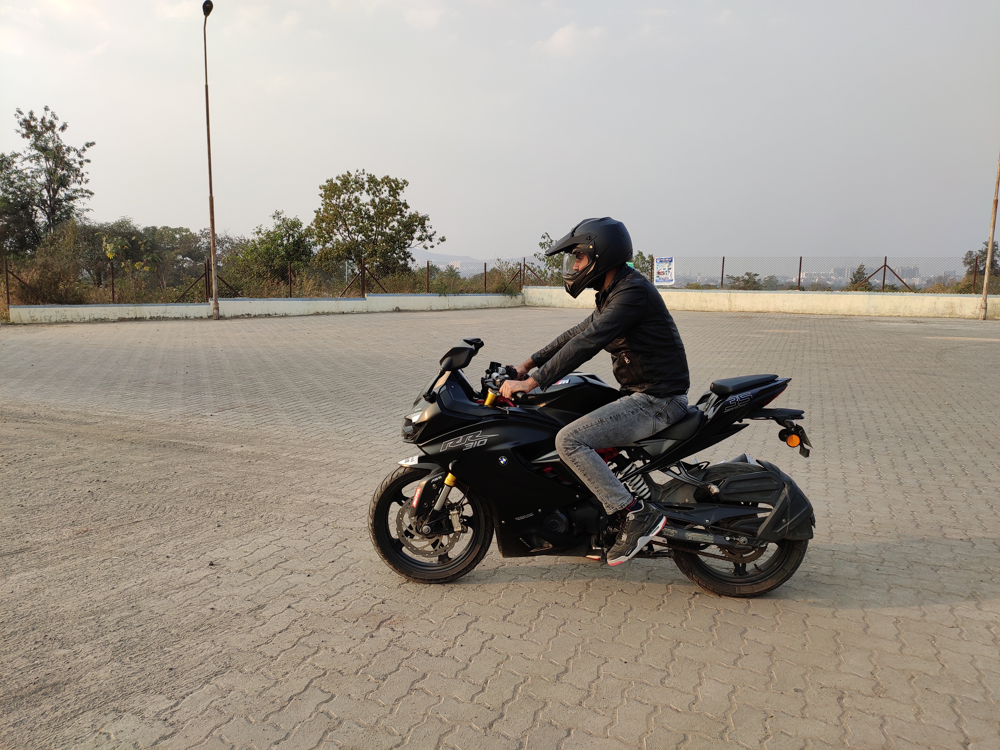

In [6]:
from PIL import Image, ImageDraw
import requests
import torch

url = '/content/IMG_20200201_172541.jpg'

# if the image is from the Web
if url.startswith('http'):
    image = Image.open(requests.get(url, stream=True).raw)
else:
    # the image is local
    image = Image.open(url)
image

In [7]:
inputs = image_processor(images = image, 
                         return_tensors = "pt")

In [8]:
outputs = model(**inputs)

In [9]:
# create the target size in the format of (height,width)
target_sizes = torch.tensor([image.size[::-1]])

results = image_processor.post_process_object_detection(outputs,
                                                        target_sizes = target_sizes, 
                                                        threshold = 0.9)[0]
results

{'scores': tensor([0.9996, 0.9991], grad_fn=<IndexBackward0>),
 'labels': tensor([1, 4]),
 'boxes': tensor([[1972.7821,  866.4070, 2783.7329, 2248.4233],
         [1455.1277, 1349.9773, 3268.3271, 2398.7756]],
        grad_fn=<IndexBackward0>)}

Detected person with confidence 1.0 at location [1972.78, 866.41, 2783.73, 2248.42]
Detected motorcycle with confidence 0.999 at location [1455.13, 1349.98, 3268.33, 2398.78]


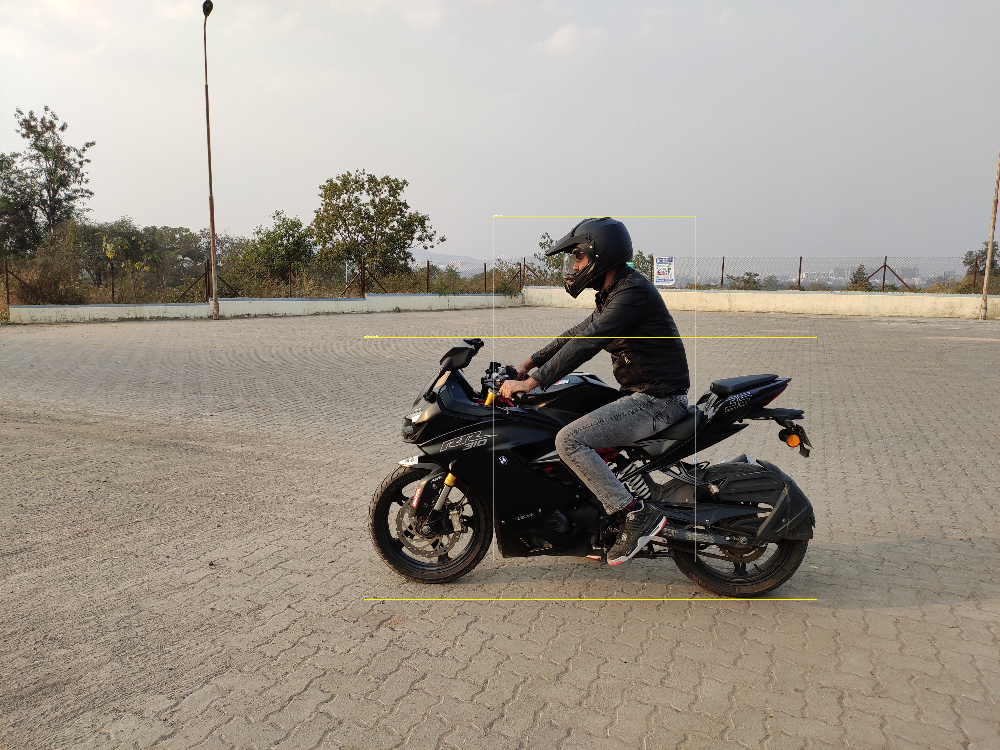

In [10]:
draw = ImageDraw.Draw(image)

for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    print(
        f"Detected {model.config.id2label[label.item()]} with confidence "
        f"{round(score.item(), 3)} at location {box}"        
    )
    # draw bounding box around object
    draw.rectangle(box, 
                   outline="yellow", 
                   width=2)
    # display the object label
    draw.text((box[0], box[1]-10), 
              model.config.id2label[label.item()], 
              fill="white")  
image